load packages

In [1]:
using JuMIT
using Statistics
using Plots
pyplot()

Plots.PyPlotBackend()

create simple (almost) homogeneous acoustic model

In [2]:
model=J.Gallery.Seismic(:acou_homo1)
J.Models.Seismic_addon!(model, randn_perc=0.01)

JuMIT.Models.Seismic([1500.0, 3500.0], [1.0, 1.0], [1500.0, 3500.0], [-9.52137e-5 0.00014956 … -4.54027e-5 -5.2299e-6; -8.02192e-5 -0.00012746 … 2.55241e-5 -0.000141719; … ; -0.000159935 -2.12078e-5 … -1.8602e-5 0.000114412; -5.61852e-5 4.2477e-5 … -4.54826e-5 -6.68946e-5], [1.22708e-5 -5.56618e-5 … -0.000133567 -3.41511e-5; 6.52293e-6 -0.000182576 … -1.49547e-5 3.51468e-5; … ; 0.000126307 0.000124387 … -0.000147881 0.000223867; -4.67994e-5 -3.16487e-5 … -1.57916e-5 7.31238e-5], [-0.00026715 -9.29328e-5 … -0.000121402 0.000194955; 0.000176873 -6.2105e-5 … 2.61281e-5 3.43828e-5; … ; 3.61952e-5 4.2964e-5 … 7.11688e-5 -2.09716e-5; 0.000214971 -2.46589e-5 … -0.000146141 -0.000224666], StepRangeLen{Float64,Base.TwicePrecision{Float64},Base.TwicePrecision{Float64}}[-1000.0:10.0:1000.0, -1000.0:10.0:1000.0], [3.375e9, 4.2875e10], [1500.0, 3500.0], [2.33236e-11, 2.96296e-10], [0.000285714, 0.000666667], [0.000285714, 0.000666667], JuMIT.Models.Seismic_ref{Float64}(2500.0, 1.0, 2500.0, 2.3125e1

a simple acquisition geometry

In [3]:
acqgeom = JuMIT.Gallery.Geom(model.mgrid,:xwell);

	Acquisition Geometry:	xwell
	> number of supersources:	2
	> sources per supersource:	min	1	max	1
	> receivers per supersource:	min	2	max	2
	> number of unique positions of:	sources	2	receivers	2


plot the model and source, receivers

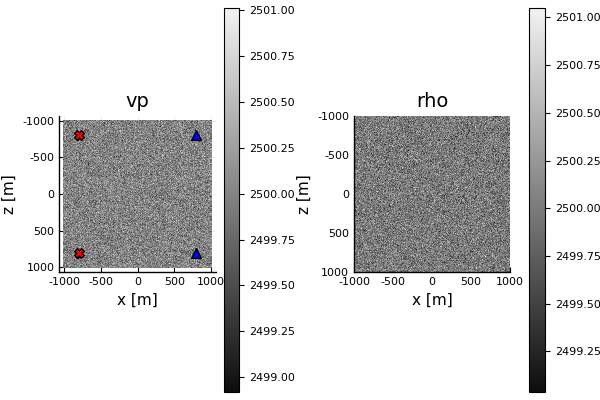

In [4]:
p1=JP.seismic(model)
JP.geom!(acqgeom)
plot(p1)

generate time grid

In [5]:
tgrid = range(0.0,stop=2.0,length=1000)

0.0:0.002002002002002002:2.0

Ricker wavelet

In [6]:
wav = JuMIT.Utils.Wavelets.ricker(10.0, tgrid, tpeak=0.25,);

distribute the same source wavelet to all the supsersources

In [7]:
acqsrc=JuMIT.Acquisition.Src_fixed(acqgeom.nss,1,[:P],wav,tgrid);

create `Fdtd.Param` object to prepare forward modelling
* npw corresponds to the number of independently propagating wavefields (1 in most cases)

In [8]:
pa=JuMIT.Fdtd.Param(npw=1,model=model,
	acqgeom=[acqgeom], acqsrc=[acqsrc],
	sflags=[2], rflags=[1],
	tgridmod=tgrid, verbose=true);

┌ Info: spatial sampling (1.00e+01) can be as high as 1.02e+01
└ @ JuMIT.Fdtd /math/home/pawbz/.julia/dev/JuMIT/src/Fdtd/Fdtd.jl:1001
┌ Warning: decrease time sampling (2.00e-03) below 1.43e-03
└ @ JuMIT.Fdtd /math/home/pawbz/.julia/dev/JuMIT/src/Fdtd/Fdtd.jl:1012


Once the `Param` object is created, do the modelling "without any memory allocations" using `mod!`

In [9]:
@time JuMIT.Fdtd.mod!(pa);

	modeling supershot 1/2 100%|███████████████████████████| Time: 0:00:02
	modeling supershot 2/2 100%|███████████████████████████| Time: 0:00:02
 ──────────────────────────────────────────────────────────────────────────
                                   Time                   Allocations      
                           ──────────────────────   ───────────────────────
     Tot / % measured:          4.66s / 100%             233KiB / 98.2%    

 Section           ncalls     time   %tot     avg     alloc   %tot      avg
 ──────────────────────────────────────────────────────────────────────────
 mod_per_proc!          1    4.65s   100%   4.65s    182KiB  79.5%   182KiB
 initialize!            1   2.51ms  0.05%  2.51ms   36.6KiB  16.0%  36.6KiB
 record data            1    170μs  0.00%   170μs   8.31KiB  3.64%  8.31KiB
 stack_grads!           1    116μs  0.00%   116μs   2.05KiB  0.90%  2.05KiB
 update gradient        1    253ns  0.00%   253ns         -  0.00%        -
 ──────────────────

plot a record after modelling

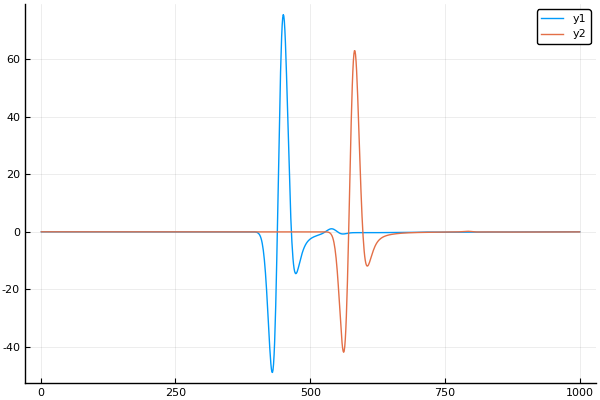

In [10]:
plot(pa.c.data[1].d[1,1])

create new seismic model

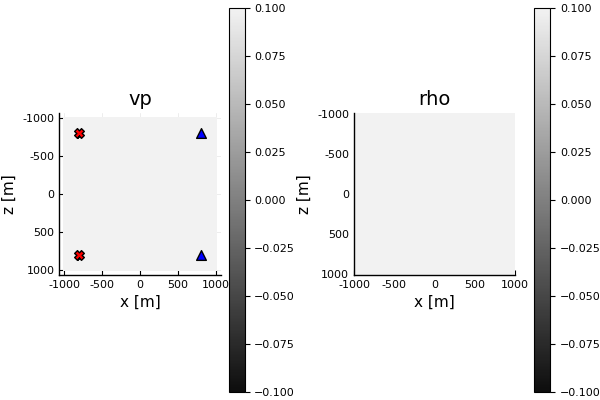

In [11]:
model_new=J.Gallery.Seismic(:acou_homo1) # prepare another model
J.Models.Seismic_addon!(model, randn_perc=0.01)
J.Models.Seismic_addon!(model_new, constant_pert=0.01) # perturb the model
p2=JP.seismic(model_new) # plot new model
JP.geom!(acqgeom)
plot(p2)

Now, we the change the model in the `Param` object without memory allocation
This routine can be used during FWI,
where medium parameters are itertively updated in the same `Fdtd.Param` object

In [12]:
J.Fdtd.update_model!(pa.c, model_new)

run modelling now and plot data again

In [13]:
@time JuMIT.Fdtd.mod!(pa);

	modeling supershot 1/2 100%|███████████████████████████| Time: 0:00:02
	modeling supershot 2/2 100%|███████████████████████████| Time: 0:00:02
 ──────────────────────────────────────────────────────────────────────────
                                   Time                   Allocations      
                           ──────────────────────   ───────────────────────
     Tot / % measured:          4.68s / 100%             233KiB / 98.2%    

 Section           ncalls     time   %tot     avg     alloc   %tot      avg
 ──────────────────────────────────────────────────────────────────────────
 mod_per_proc!          1    4.67s   100%   4.67s    182KiB  79.4%   182KiB
 initialize!            1   4.84ms  0.10%  4.84ms   36.7KiB  16.0%  36.7KiB
 record data            1   87.1μs  0.00%  87.1μs   8.44KiB  3.69%  8.44KiB
 stack_grads!           1   46.2μs  0.00%  46.2μs   2.05KiB  0.89%  2.05KiB
 update gradient        1    330ns  0.00%   330ns         -  0.00%        -
 ──────────────────

plot a record after modelling

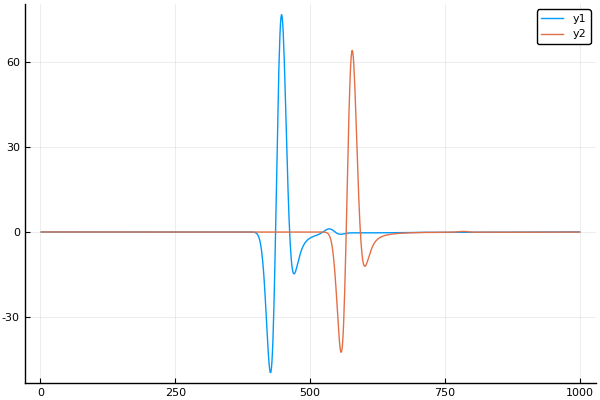

In [14]:
plot(pa.c.data[1].d[1,1])

*This notebook was generated using [Literate.jl](https://github.com/fredrikekre/Literate.jl).*